# Introduction

This project deals with the analysis of the car fuel economy data from the US EPA dataset: https://www.fueleconomy.gov/feg/download.shtml 
The particular file being analyzed is https://www.fueleconomy.gov/feg/epadata/vehicles.csv.zip “Datasets for All Model Years (1984–2019)”. The data dictionary is here: https://www.fueleconomy.gov/feg/ws/index.shtml#vehicle

Some questions that are in particular focus in this analysis:

1. Which manufacturer produces the most fuel efficient fleet of cars?

2. Build a model to predict city mpg (variable “UCity” in column BG).

3. How has fuel economy changed over time? Are there any other interesting insights or trends?



# Library Imports

* All necessary libraries will be imported here or mentioned here 

In [3]:
#Several scikit-learn modules are used in the later part of the notebook
import pandas as pd
import numpy as np
import time
import matplotlib.pyplot as plt
%matplotlib inline
from pandas_profiling import ProfileReport 
#Please install the latest version pandas_profiling 2.5
#This can be installed through Conda using:
#conda install -c conda-forge/label/cf202003 pandas-profiling
import seaborn as sns
sns.set()

# Rapid EDA and Data Processing of Raw Data 

* The Pandas Profiling library will be used to explore the raw data and gain a first order understanding of the data

In [4]:
car_data = pd.read_csv('vehicles.csv')
profile = ProfileReport(car_data, title='All Cars 1st Pass Profiling Report', html={'style':{'full_width':True}})
profile.to_notebook_iframe()

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3063: DtypeWarning: Columns (73,74,76) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


## 1st pass column drops

Based on the profiled summaries the following columns can be immediately dropped:
* `charge120` since it has a constant value of 0
* `c240bDscr` too many missing values and electric vehicle alternater charger description is unnecessary
* `c240Dscr` too many missing values and electric vehicle charger description is unnecessary
* `cityCD` too many zeros
* `cityE` city electricity consumption in kw-hrs/100 miles is irrelevant information
* `cityUF` EPA city utility factor (share of electricity) for PHEV irrelevant information
* `combinedCD` too many missing values
* `combinedUF ` too many missing values
* `highwayCD` too many missing values
* `highwayE` too many missing values
* `highwayUF` too many missing values
* `createdOn` data entry dates are irrelevant assuming adjustments due to EPA changes are included in the data
* `modifiedOn` data modified dates are irrelevant assuming adjustments due to EPA changes are included in the data


In [5]:
car_data.drop(['charge120','c240bDscr','c240Dscr','cityCD','cityE',
               'cityUF','combinedCD','combinedUF','highwayCD','highwayE',
               'highwayUF','createdOn','modifiedOn'],axis=1, inplace=True, errors='raise')

## Distinguishing alternative vehicles and gasoline vehicles

Quick study into the data makes it obvious that some columns are specific for alternative vehicles only. These columns may contain more information for those classes of vehicles while it may not be useful for gasoline vehicle. Hence the data will now be segmented and re-profiled to perform more cleaning.

In [6]:
atv_car_data = car_data[car_data['atvType'].notna()]
gas_car_data = car_data[car_data['atvType'].isna()]
ProfileReport(gas_car_data, title='Gasoline Cars 1st Pass Profiling Report', html={'style':{'full_width':True}}).to_notebook_iframe()

Only the gasoline car dataset is selected for further study due to the greater amount of data available for study and the time constraint. 

### 1st pass column drops for gasoline cars

Based on the profiled summaries the following columns can be immediately dropped:
* `atvType` no values by design
* `barrelsA08` no values
* `co2` repeat of `co2TailpipeGpm`
* `charge240` no values
* `charge240b` no values
* `cityA08` no values
* `cityA08U` no values
* `city08U` rounded values are close enough and take less memory space
* `co2A` constant
* `co2TailpipeAGpm` constant
* `combA08` no values
* `combA08U` no values
* `combE` no values
* `evMotor` no values
* `fuelCostA08` no values
* `fuelType2` no values
* `highwayA08` no values
* `highwayA08U` no values
* `phevBlended` no values
* `phevCity` no values
* `phevComb` no values
* `phevHwy` no values
* `range` no values
* `rangeA` no values
* `rangeCity` no values
* `rangeCityA` no values
* `rangeHwy` no values
* `rangeHwyA` no values
* `UCityA` no values
* `UHighwayA` no values

In [7]:
gas_car_data.drop(['atvType','barrelsA08', 'charge240', 'charge240b', 'cityA08',
                   'cityA08U', 'co2', 'co2A', 'city08U', 'co2TailpipeAGpm', 'combA08', 'combA08U',
                  'combE', 'evMotor', 'fuelCostA08', 'fuelType2', 'highwayA08', 
                  'highwayA08U', 'phevBlended', 'phevCity', 'phevComb', 'phevHwy',
                  'range', 'rangeA', 'rangeCity', 'rangeCityA', 'rangeHwy', 'rangeHwyA',
                  'UCityA', 'UHighwayA'],axis=1, inplace=True, errors='raise')

## Further EDA and data cleaning on gasoline car dataset

* `cylinders` can be turned into category variable after missing values are filled
* `comb08U` will be dropped since it does not add much information
* `displ` can be filled
* `drive` can be converted into category type
* `engId` EPA model type index does not provide much info
* `feScore` replace -1 with NaNs
* `fuelType` can be converted into category type
* `fuelType1` can be dropped since no double fuel type cars are present in this dataset
* `ghgScore` replace -1 with NaNs
* `ghgScoreA` can be dropped, not much info
* `guzzler` can be consolidated as a binary variable
* `highway08U` can be dropped since the highway08 provides rounded data
* `id` record id is irrelevant 
* `mfrCode` make and model is already present so this is irrelevant
* `mpgData` convert into category type
* `pv2` and `lv2` can be added to create a single column for 2 door cars
* `pv4` and `lv4` can be added to create a single column for 4 door cars
* `startStop` is dropped, not enough data
* `sCharger` and `tCharger` will be converted into binary variables
* `trany` missing values are dropped
* `UCity` rows with values that are less than 1 are dropped
* `VClass` can be converted into categorical type
* `year` can be converted into categorical type

In [8]:
gas_car_data.loc[21413,'cylinders'] = 4 #1985 Subaru RX Turbo had 4 cylinders
gas_car_data.loc[21414,'cylinders'] = 4 #1985 Subaru RX Turbo had 4 cylinders
gas_car_data.loc[21506,'cylinders'] = 2 #1986 Maxda RX-7 had two cylinders
gas_car_data.cylinders = gas_car_data.cylinders.astype('int').astype('category')

gas_car_data.loc[21413, 'displ'] = 1.8 #1985 Subaru RX Turbo had 1.78 L engine
gas_car_data.loc[21414, 'displ'] = 1.8 #1985 Subaru RX Turbo had 1.78 L engine

gas_car_data['drive'] = gas_car_data.drive.astype('category')

gas_car_data['v2'] = gas_car_data.pv2 + gas_car_data.lv2
gas_car_data['v4'] = gas_car_data.pv4 + gas_car_data.lv4

gas_car_data['sCharger'] = gas_car_data.sCharger == 'S'
gas_car_data['tCharger'] = gas_car_data.tCharger == 'T'

gas_car_data.drop(gas_car_data[gas_car_data.trany.isna()].isna().index, axis=0, inplace=True )
gas_car_data.drop(gas_car_data[gas_car_data.UCity < 1].index, axis=0, inplace=True )


gas_car_data.drop(['comb08U','engId','fuelType1','ghgScoreA', 'highway08U', 
                   'id', 'mfrCode', 'pv2', 'pv4', 'lv2', 'lv4', 
                   'startStop'],axis=1, inplace=True, errors='raise')

gas_car_data.feScore.replace(-1,np.nan,inplace=True)

gas_car_data['fuelType'] = gas_car_data.fuelType.astype('category')   

gas_car_data.ghgScore.replace(-1,np.nan,inplace=True)

gas_car_data.guzzler.replace('T',1,inplace=True)
gas_car_data.guzzler.replace('G',1,inplace=True)
gas_car_data.guzzler.replace('S',np.nan,inplace=True)
gas_car_data['guzzler'] = gas_car_data.guzzler == 1

gas_car_data.mpgData.replace('True',1,inplace=True)
gas_car_data.mpgData.replace('False',0,inplace=True)

gas_car_data['VClass'] = gas_car_data.VClass.astype('category')

gas_car_data['year'] = gas_car_data.year.astype('category')

In [9]:
ProfileReport(gas_car_data, title='Gasoline Cars 2nd Pass Profiling Report', html={'style':{'full_width':True}}).to_notebook_iframe()

---

# Exploring mileage data

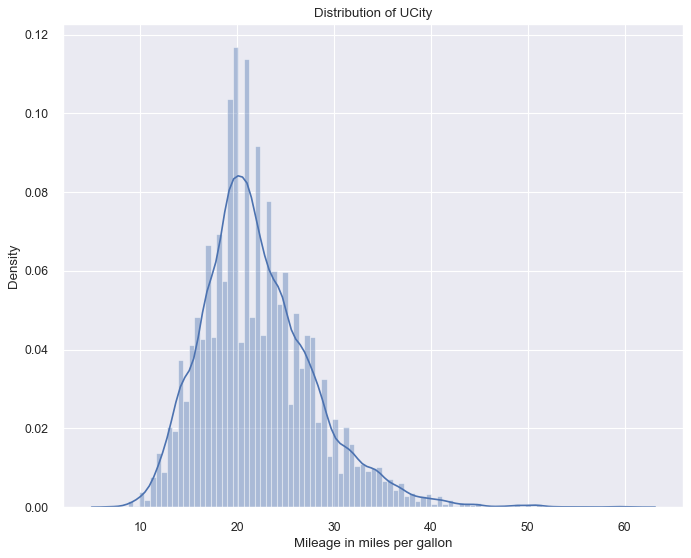

In [10]:
plt.figure(figsize=(10, 8), dpi= 80)
sns.distplot(gas_car_data.UCity, bins=int(np.sqrt(gas_car_data.UCity.shape[0]/4)), 
             hist=True, kde=True, rug=False)
plt.title('Distribution of UCity')
plt.xlabel('Mileage in miles per gallon')
plt.ylabel('Density')
plt.show()

Plotting all mileages for all classes of car for all years seems, it can be seen that mileage data is somewhat normally distributed with a longer tail at the end.

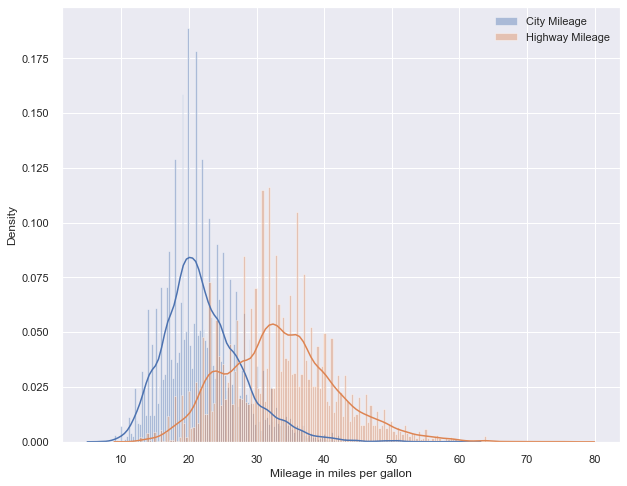

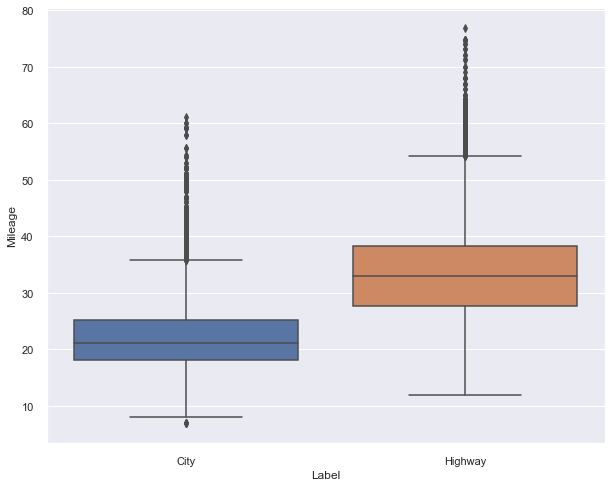

In [11]:
plt.figure(figsize=(10, 8))
sns.distplot(gas_car_data.UCity, bins=int(np.sqrt(gas_car_data.UCity.shape[0])), 
             hist=True, kde=True, rug=False)
sns.distplot(gas_car_data.UHighway, bins=int(np.sqrt(gas_car_data.UHighway.shape[0])), 
             hist=True, kde=True, rug=False)
plt.xlabel('Mileage in miles per gallon')
plt.ylabel('Density')
plt.legend(labels=['City Mileage', 'Highway Mileage'])
plt.show()


snsmlgtemp = pd.DataFrame(pd.concat([gas_car_data.UCity,
                       gas_car_data.UHighway]))
#Creating hue labels for Seaborn
snsmlgtemp['Label'] = ['City']*gas_car_data.shape[0] + ['Highway']*gas_car_data.shape[0]
snsmlgtemp.columns = ['Mileage','Label']

plt.figure(figsize=(10, 8))
sns.boxplot(y='Mileage',x='Label',data=snsmlgtemp)
plt.show()

Qualitively it can be seen that highway mileages are greater than city mileages

# Looking at fuel efficiency of manufacturers and vehicle class over years

Mileage can be conditioned over different manufacturers and years to see which manufacturers produced the most fuel efficient cars over the years. 

In the analysis below, a pivot table will be used to find the <b>mean</b> mileage of all cars for each manufacturer for each year. Then the best performer (max of mean) for each year will be chosen. This manufacturer produced cars with the best mileage for that particular year. 

In [12]:
def pivot_plot(df, lim_year, ind, col, val, aggfunc, title, xlabel, ylabel, ylim, annspace, VClass=False):
    """
    Function to rapidly pivot, plot, and annotate data
    """
    make_df = df[df.year.astype(int) > lim_year].pivot_table(index = [ind], columns = [col], 
                                                             values= [val], aggfunc = aggfunc).T
    if VClass:
        make_df = pd.DataFrame(make_df.values, columns=make_df.columns, index = [ind[1] for ind in make_df.index]).dropna(axis=1,thresh=4)
    else:
        make_df.reset_index(inplace=True)
        make_df.index = make_df.year
        make_df.drop(['level_0',col],axis=1,inplace=True)
        make_df.dropna(axis=1,thresh=4,inplace=True)

    plt.figure(figsize=(16, 8))
    plt.scatter(x=make_df.index.astype(int),y=make_df.max(axis=1).values)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.ylim(ylim)
    
    for i,j,k in zip(make_df.index.astype(int),make_df.idxmax(axis=1),make_df.max(axis=1)):
        plt.annotate(s=j,xy=(i,k),xytext=(i,k+annspace))
    plt.show()
    
    print('Count of unique values: \n')
    print(make_df.idxmax(axis=1).value_counts())
    print('\nDetailed values: \n')
    print(pd.concat([make_df.max(axis=1),make_df.idxmax(axis=1)],axis=1))

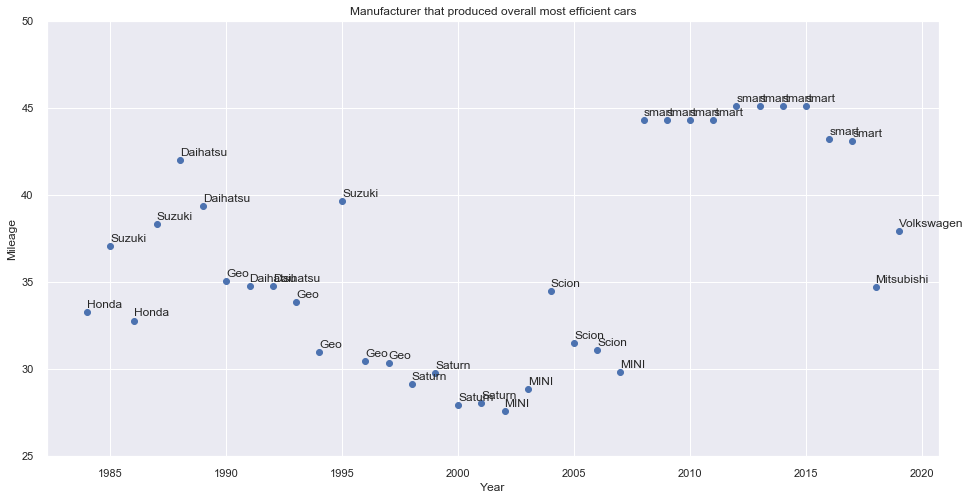

Count of unique values: 

smart         10
Geo            5
Daihatsu       4
Saturn         4
Suzuki         3
MINI           3
Scion          3
Honda          2
Mitsubishi     1
Volkswagen     1
dtype: int64

Detailed values: 

              0           1
year                       
1984  33.250000       Honda
1985  37.083350      Suzuki
1986  32.777775       Honda
1987  38.323520      Suzuki
1988  42.000000    Daihatsu
1989  39.361100    Daihatsu
1990  35.065553         Geo
1991  34.750000    Daihatsu
1992  34.750000    Daihatsu
1993  33.850000         Geo
1994  30.967247         Geo
1995  39.666667      Suzuki
1996  30.466673         Geo
1997  30.348153         Geo
1998  29.135267      Saturn
1999  29.734717      Saturn
2000  27.942481      Saturn
2001  28.008188      Saturn
2002  27.593500        MINI
2003  28.864500        MINI
2004  34.475000       Scion
2005  31.500000       Scion
2006  31.083333       Scion
2007  29.797962        MINI
2008  44.300000       smart
2009  44.300000

In [13]:
pivot_plot(gas_car_data, 1980, 'make', 'year', 'UCity', 'mean', 
           'Manufacturer that produced overall most efficient cars', 'Year', 
           'Mileage',(25,50), .25)

Judging by the plot above it may seem like `Smart` produced the most efficient cars. However, looking at the data of all `Smart` cars, it can be seen that their fleet is limited to a single class of cars, the `Two Seaters`. Hence, further investigation is warranted. 

In [14]:
print('Smart Car details: \n')
gas_car_data[gas_car_data['make']=='smart'][['model','year','UCity','VClass']]

Smart Car details: 



,model,year,UCity,VClass
16657,fortwo convertible,2008,44.3000,Two Seaters
16658,fortwo coupe,2008,44.3000,Two Seaters
17923,fortwo convertible,2009,44.3000,Two Seaters
17924,fortwo coupe,2009,44.3000,Two Seaters
21784,fortwo cabriolet,2010,44.3000,Two Seaters
21785,fortwo coupe,2010,44.3000,Two Seaters
22973,fortwo cabriolet,2011,44.3000,Two Seaters
22974,fortwo coupe,2011,44.3000,Two Seaters
24360,fortwo coupe,2012,45.1156,Two Seaters
24361,fortwo cabriolet,2012,45.1156,Two Seaters


---

We can see that the class of the car plays a large role in deciding mileage. Hence, in the below analysis we will see which class of cars consistently acheive best mileage by pivoting on `VClass` and finding max of means. 

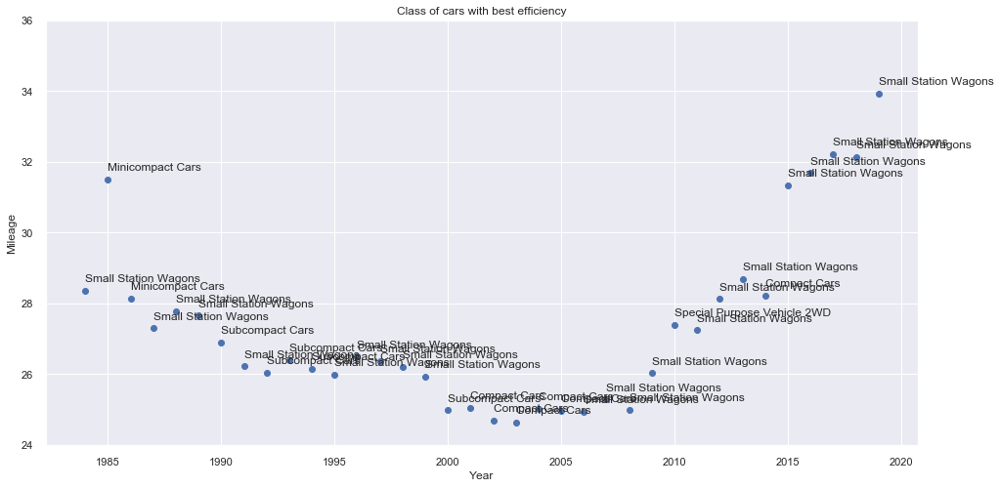

Count of unique values: 

Small Station Wagons           22
Compact Cars                    6
Subcompact Cars                 5
Minicompact Cars                2
Special Purpose Vehicle 2WD     1
dtype: int64

Detailed values: 

              0                            1
1984  28.348624         Small Station Wagons
1985  31.507929             Minicompact Cars
1986  28.134495             Minicompact Cars
1987  27.296296         Small Station Wagons
1988  27.775895         Small Station Wagons
1989  27.651516         Small Station Wagons
1990  26.888835              Subcompact Cars
1991  26.218513         Small Station Wagons
1992  26.044172              Subcompact Cars
1993  26.389459              Subcompact Cars
1994  26.141614              Subcompact Cars
1995  25.991108         Small Station Wagons
1996  26.497352         Small Station Wagons
1997  26.370372         Small Station Wagons
1998  26.206574         Small Station Wagons
1999  25.939004         Small Station Wagons
2000  

In [15]:
pivot_plot(gas_car_data, 1980, 'VClass', 'year', 'UCity', 'mean', 
           'Class of cars with best efficiency', 'Year', 
           'Mileage',(24,36), .25, VClass=True)

Suprisingly, as a whole, `Small Station Wagons` consistently exhibit some of the best efficiency.  

There are two observations that are very apparent:
* We need to look at the most efficient cars in each vehicle class to have a better idea of the best manufacterer in the context of fuel efficiency
* Years 2009-2019 need a careful examination since fuel efficiency consistently increased during this period 

## Conditioning over manufacturer and class together

In the below analysis, the overall best performing manufacturer (max of mean) over each vehicle class will be found by creating a miultilevel pivot table. 

The following classes will be ignored due to lack of data:
* `Standard Pickup Trucks/2wd`
* `Special Purpose Vehicles/2wd`
* `Special Purpose Vehicles/4wd`
* `Vans Passenger`

### All dates

In [16]:
make_mpg = gas_car_data.pivot_table(index = ['make'], columns = ['year','VClass'], 
                                    values= ['UCity'], aggfunc = 'mean').T

man_list =[]
count = []
class_nam = []

for vclass_val in gas_car_data.VClass.value_counts().drop(['Standard Pickup Trucks/2wd',
                                                           'Special Purpose Vehicles/2wd',
                                                           'Special Purpose Vehicles/4wd',
                                                           'Vans Passenger']).index:
    temp_df = make_mpg.loc[(('UCity', slice(1984,2019), vclass_val)),:]
    temp_df.reset_index(inplace=True)
    temp_df.index = temp_df.year
    temp_df.drop(['level_0','year','VClass'],axis=1,inplace=True)
    temp_df.dropna(axis=1,thresh=4,inplace=True)
    
    man_list.append(temp_df.idxmax(axis=1).value_counts().index[0])
    count.append(temp_df.idxmax(axis=1).value_counts()[0])
    class_nam.append(vclass_val)

tot_df = pd.DataFrame({'Manufacturer':man_list, 'Counts':count, 'Class':class_nam})   
print('Data: ')
print(tot_df)
print('\nManufacturers that won the most number of vehicle classes: \n')
print(tot_df.Manufacturer.value_counts()[:5])
print('\nTop 3 sum of counts over all vehicle classes:')
tot_df.groupby(['Manufacturer']).sum().sort_values(by='Counts',ascending=False)[:3]

Data: 
   Manufacturer  Counts                               Class
0         Honda       6                        Compact Cars
1        Suzuki      11                     Subcompact Cars
2       Hyundai       9                        Midsize Cars
3         Mazda       8              Standard Pickup Trucks
4         smart      10                         Two Seaters
5        Subaru       8         Sport Utility Vehicle - 4WD
6        Toyota      13                          Large Cars
7         Honda      15                Small Station Wagons
8         Honda       4         Sport Utility Vehicle - 2WD
9        Suzuki      10            Special Purpose Vehicles
10         MINI      10                    Minicompact Cars
11       Toyota      12                                Vans
12        Mazda       8          Standard Pickup Trucks 2WD
13       Toyota      10          Standard Pickup Trucks 4WD
14        Buick       4     Small Sport Utility Vehicle 4WD
15        Eagle       6        Mi

,Counts
Manufacturer,
Toyota,65
Chevrolet,31
Honda,25


The above analysis shows that `Toyota` and `Honda` manufactured the most fuel efficient range of cars on average in the 1984-2019 date range. 

But does that change for years 2009-2019 ? 

### Since 2009

In [17]:
make_mpg = gas_car_data.pivot_table(index = ['make'], columns = ['year','VClass'], values= ['UCity'], aggfunc = 'mean').T

man_list =[]
count = []
class_nam = []

for vclass_val in gas_car_data.VClass.value_counts().drop(['Standard Pickup Trucks/2wd',
                                                           'Special Purpose Vehicles/2wd',
                                                           'Special Purpose Vehicles/4wd',
                                                           'Vans Passenger']).index:
    temp_df = make_mpg.loc[(('UCity', slice(2009,2019), vclass_val)),:]
    temp_df.reset_index(inplace=True)
    temp_df.index = temp_df.year
    temp_df.drop(['level_0','year','VClass'],axis=1,inplace=True)
    temp_df.dropna(axis=1,thresh=4,inplace=True)
    
    try:
        man_list.append(temp_df.idxmax(axis=1).value_counts().index[0])
    except:
        man_list.append(np.nan)
    try:
        count.append(temp_df.idxmax(axis=1).value_counts()[0])
    except:
        count.append(np.nan)  
    class_nam.append(vclass_val)

tot_df = pd.DataFrame({'Manufacturer':man_list, 'Counts':count, 'Class':class_nam})   
print('Data: ')
print(tot_df)
print('\nManufacturers that won the most number of vehicle classes: \n')
print(tot_df.Manufacturer.value_counts()[:5])
print('\nTop 3 sum of counts over all vehicle classes:')
tot_df.groupby(['Manufacturer']).sum().sort_values(by='Counts',ascending=False)[:3]

Data: 
   Manufacturer  Counts                               Class
0        Toyota     4.0                        Compact Cars
1        Toyota     5.0                     Subcompact Cars
2       Hyundai     6.0                        Midsize Cars
3           NaN     NaN              Standard Pickup Trucks
4         smart     9.0                         Two Seaters
5    Mitsubishi     2.0         Sport Utility Vehicle - 4WD
6         Honda     6.0                          Large Cars
7         Honda    10.0                Small Station Wagons
8    Mitsubishi     2.0         Sport Utility Vehicle - 2WD
9           NaN     NaN            Special Purpose Vehicles
10         Fiat     5.0                    Minicompact Cars
11          NaN     NaN                                Vans
12         Ford     4.0          Standard Pickup Trucks 2WD
13        Honda     9.0          Standard Pickup Trucks 4WD
14        Buick     4.0     Small Sport Utility Vehicle 4WD
15          NaN     NaN        Mi

,Counts
Manufacturer,
Toyota,34.0
Honda,25.0
Ford,11.0


<b>As can be seen in the above analysis, `Toyota` manufacters the most fuel efficient cars over a range of vehicle classes with `Honda` being a consistent second. This has been true over the complete date range of 1984-2019 as well as during recent times 2009-2019. This aligns quite well with popular perception about these two manufacturers as well.</b>

---

# Modeling city mileage

To develop a promising model for mileage variable `UCity`, we need to understand the dependencies of `UCity`. 

## Exploring `UCity`

We can first explore linear relationships and look at variables that produce high pos/neg linear correlations with `UCity` and changes with some of the prominent categorical variables.

In [18]:
gas_car_data.drop(['guzzler','tCharger','sCharger'],axis=1).corrwith(gas_car_data.UCity,method='pearson')

barrels08        -0.905850
city08            0.996635
co2TailpipeGpm   -0.908902
comb08            0.987256
displ            -0.792582
feScore           0.924183
fuelCost08       -0.873337
ghgScore          0.924183
highway08         0.933706
hlv               0.276184
hpv               0.340763
UCity             1.000000
UHighway          0.939555
youSaveSpend      0.873337
v2                0.084458
v4                0.259956
dtype: float64

Some data cleaning:
* `city08` is essentially the fuel efficiency itself and should not be used in a predictive model for mileage
* `comb08` is the combined mileage and should not be used in a predictive model for mileage
* `feScore` and `ghgScore` have too many missing values and are highly correlated with other other variables and this can lead to multicollinearity issues
* `UHighway` is the highway mileage. Assuming this is a predictive model for `UCity`, this will be done in an environment where `UHighway` may not be available either.
* `eng_dscr`,`trans_dscr` is repeated information for the most part and highly missing so this will be ignored
* `year` the assumption is that the developed model will be used for future vehicles, hence `year` is irrelevant but it will not be dropped since it can be used to condition the data on year

In [19]:
gas_car_data.drop(['city08','comb08','feScore','ghgScore','eng_dscr','trans_dscr'],axis=1,inplace=True)

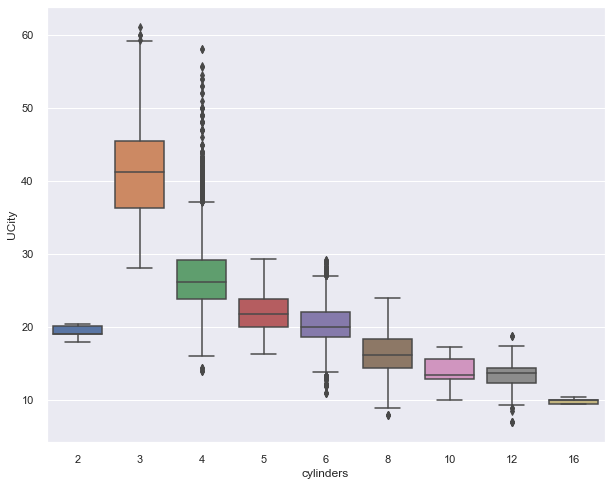

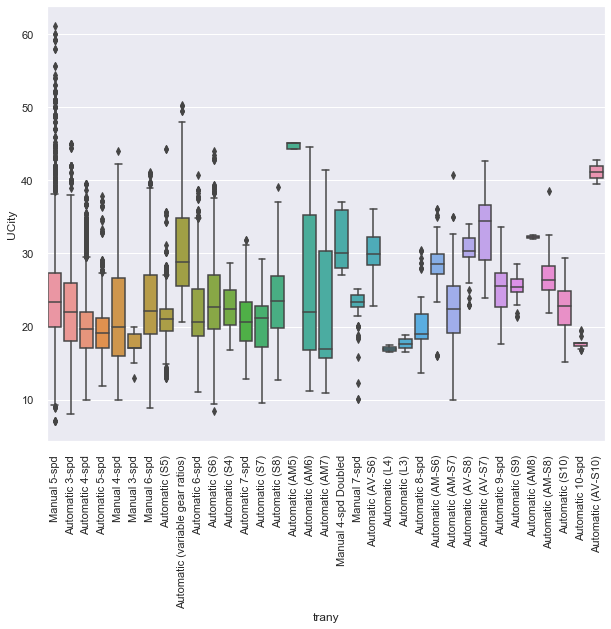

(array([0, 1]), <a list of 2 Text xticklabel objects>)

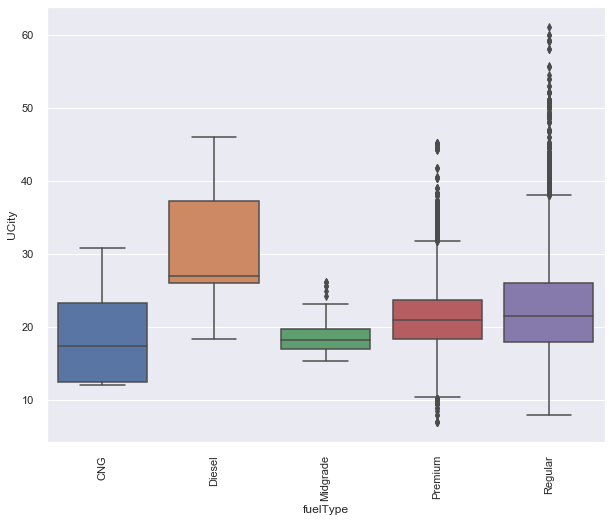

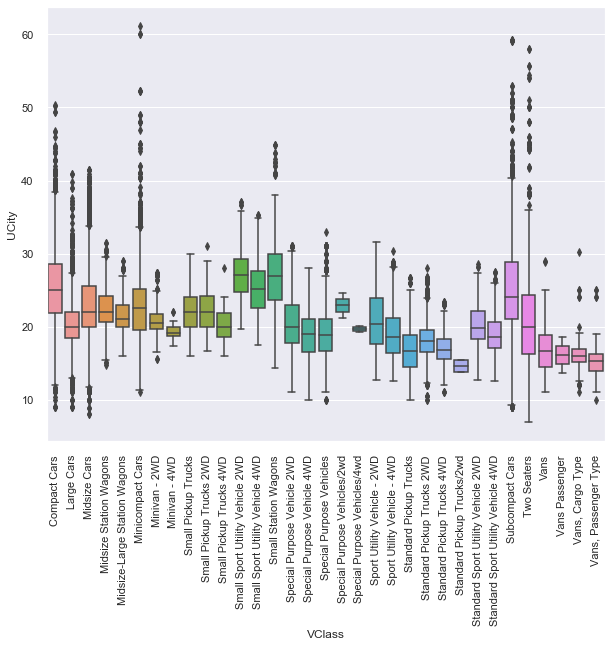

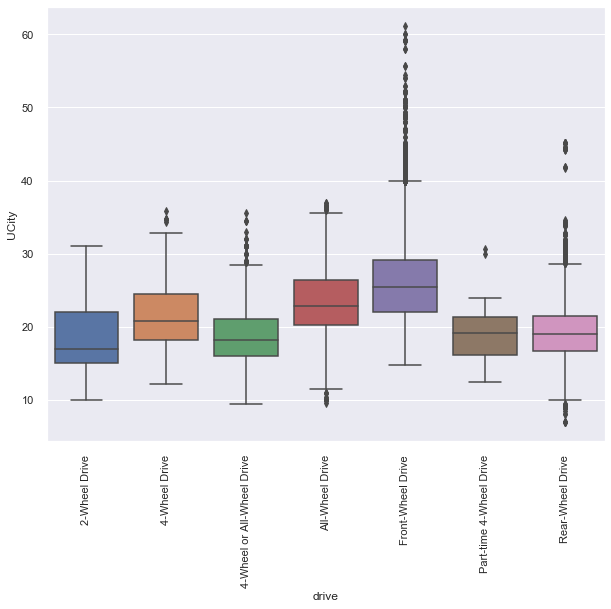

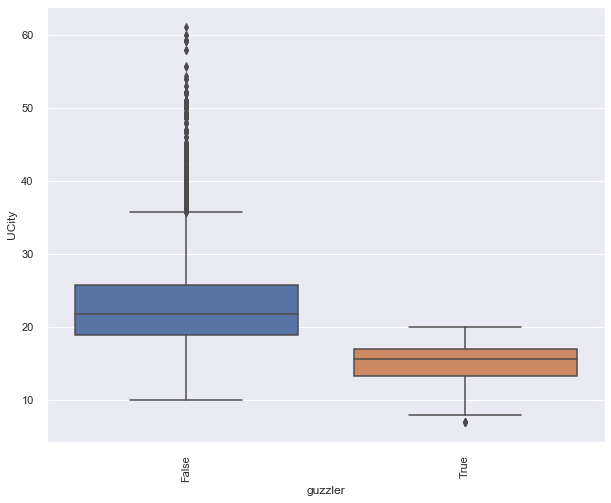

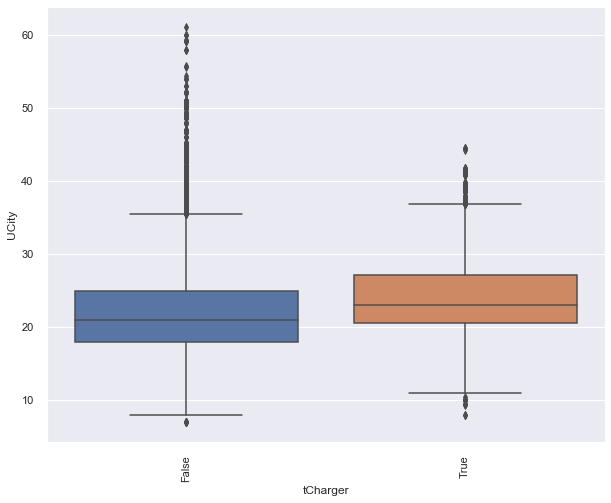

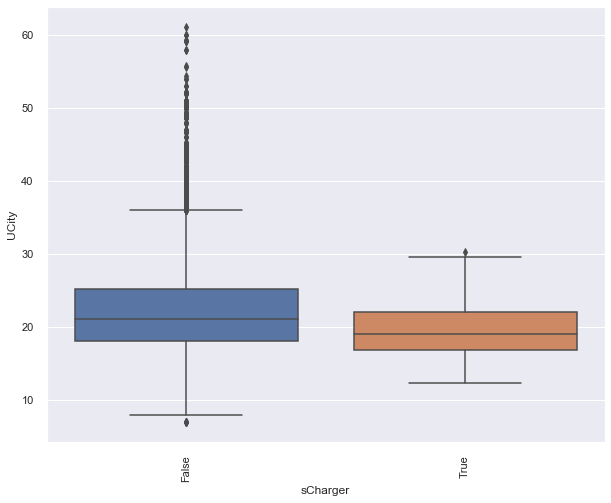

In [20]:
plt.figure(figsize=(10, 8))
sns.boxplot(y='UCity',x='cylinders',data = gas_car_data)
plt.show()

plt.figure(figsize=(10, 8))
sns.boxplot(y='UCity',x='trany',data = gas_car_data)
plt.xticks(rotation=90)
plt.show()

plt.figure(figsize=(10, 8))
sns.boxplot(y='UCity',x='fuelType',data = gas_car_data)
plt.xticks(rotation=90)

plt.figure(figsize=(10, 8))
sns.boxplot(y='UCity',x='VClass',data = gas_car_data)
plt.xticks(rotation=90)

plt.figure(figsize=(10, 8))
sns.boxplot(y='UCity',x='drive',data = gas_car_data)
plt.xticks(rotation=90)

plt.figure(figsize=(10, 8))
sns.boxplot(y='UCity',x='guzzler',data = gas_car_data)
plt.xticks(rotation=90)

plt.figure(figsize=(10, 8))
sns.boxplot(y='UCity',x='tCharger',data = gas_car_data)
plt.xticks(rotation=90)

plt.figure(figsize=(10, 8))
sns.boxplot(y='UCity',x='sCharger',data = gas_car_data)
plt.xticks(rotation=90)

## Creating a baseline model

A basic regularized linear model will be attempted at first to see what would the accuracy be, and also to find feature importance. The first pass will try to keep the model simple. 

In [21]:
preproc = gas_car_data[['barrels08','co2TailpipeGpm','displ','fuelCost08','youSaveSpend','guzzler','cylinders','tCharger','sCharger','mpgData','trany','VClass','fuelType','drive']].reset_index(drop=True)
preproc = pd.get_dummies(preproc, drop_first=True)
train = gas_car_data['UCity']

In [22]:
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import r2_score
from sklearn.linear_model import Lasso

x_train, x_test, y_train, y_test = train_test_split(preproc, train, test_size=0.3, random_state=21)

lasso = Lasso(normalize=False)
pipeline = Pipeline([('lasso',lasso)])

param_grid = {'lasso__alpha': np.linspace(0.001, 0.01, 5)}
lasso_gcv = GridSearchCV(pipeline, param_grid, cv=5,
                                     n_jobs=-1, iid=True)

lasso_gcv.fit(x_train, y_train)
sc = r2_score(lasso_gcv.predict(x_test),y_test)
print('The R2 score is: {0}, which means the model explains {1:.2f}% of the variance.'.format(sc,sc*100))


The R2 score is: 0.8885896616037565, which means the model explains 88.86% of the variance.


## Some preprocessing

This R2 score may be increased a little by adding a preprocessing step such as a standardizing step. 

In [23]:
from sklearn.preprocessing import StandardScaler

x_train, x_test, y_train, y_test = train_test_split(preproc, train, test_size=0.3, random_state=21)

lasso = Lasso(normalize=False)
scaler = StandardScaler()
pipeline = Pipeline([('scale',scaler),('lasso',lasso)])

param_grid = {'lasso__alpha': np.linspace(0.001, 0.01, 5)}
lasso_gcv = GridSearchCV(pipeline, param_grid, cv=5,
                                     n_jobs=-1, iid=True)

lasso_gcv.fit(x_train, y_train)
sc = r2_score(lasso_gcv.predict(x_test),y_test)
print('The R2 score is: {0}, which means the model explains {1:.2f}% of the variance.'.format(sc,sc*100))


The R2 score is: 0.8895889941257029, which means the model explains 88.96% of the variance.


## Feature importance

We can now perform a feature importance study to look at the drivers of this prediction model.

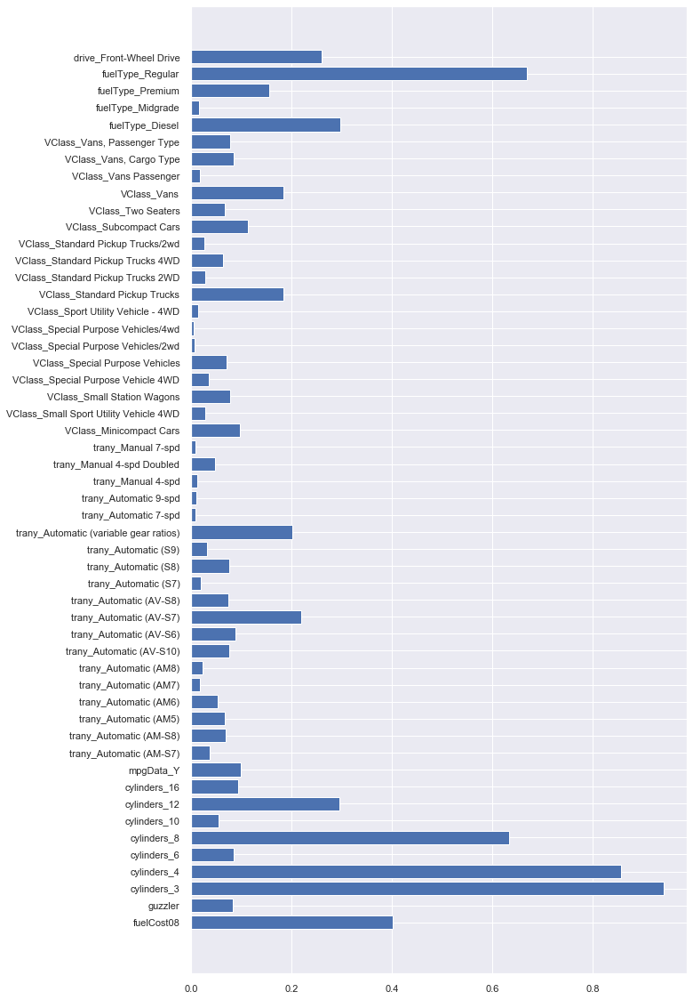

In [24]:
coefs = lasso_gcv.best_estimator_.steps[1][1].coef_
thresh = 0
t_coefs = coefs[coefs>thresh]
plt.figure(figsize=(10, 20))
plt.barh(width=np.abs(t_coefs),y=range(t_coefs.shape[0]),tick_label = x_train.columns[coefs>thresh].values)
plt.show()

It's interesting to see that the major drivers of the predictions are the annual fuel cost, and then physical parameters. This makes sense since mileage is a physical quantity after all. 

Does it change for cars manufactured after 2009, with the increased importance for mileage ?

In [25]:
preproc = gas_car_data[gas_car_data.year.astype(int) >= 2009][['barrels08','co2TailpipeGpm','displ','fuelCost08','youSaveSpend','guzzler','cylinders','tCharger','sCharger','mpgData','trany','VClass','fuelType','drive']].reset_index(drop=True)
preproc = pd.get_dummies(preproc, drop_first=True)
train = gas_car_data[gas_car_data.year.astype(int) >= 2009]['UCity']

In [26]:
x_train, x_test, y_train, y_test = train_test_split(preproc, train, test_size=0.3, random_state=21)

lasso = Lasso(normalize=False)
scaler = StandardScaler()
pipeline = Pipeline([('scale',scaler),('lasso',lasso)])

param_grid = {'lasso__alpha': np.linspace(0.001, 0.01, 5)}
lasso_gcv = GridSearchCV(pipeline, param_grid, cv=5,
                                     n_jobs=-1, iid=True)

lasso_gcv.fit(x_train, y_train)
sc = r2_score(lasso_gcv.predict(x_test),y_test)
print('The R2 score is: {0}, which means the model explains {1:.2f}% of the variance.'.format(sc,sc*100))


The R2 score is: 0.9365098740984625, which means the model explains 93.65% of the variance.


We can now perform a feature importance study to look at the drivers of this prediction model.

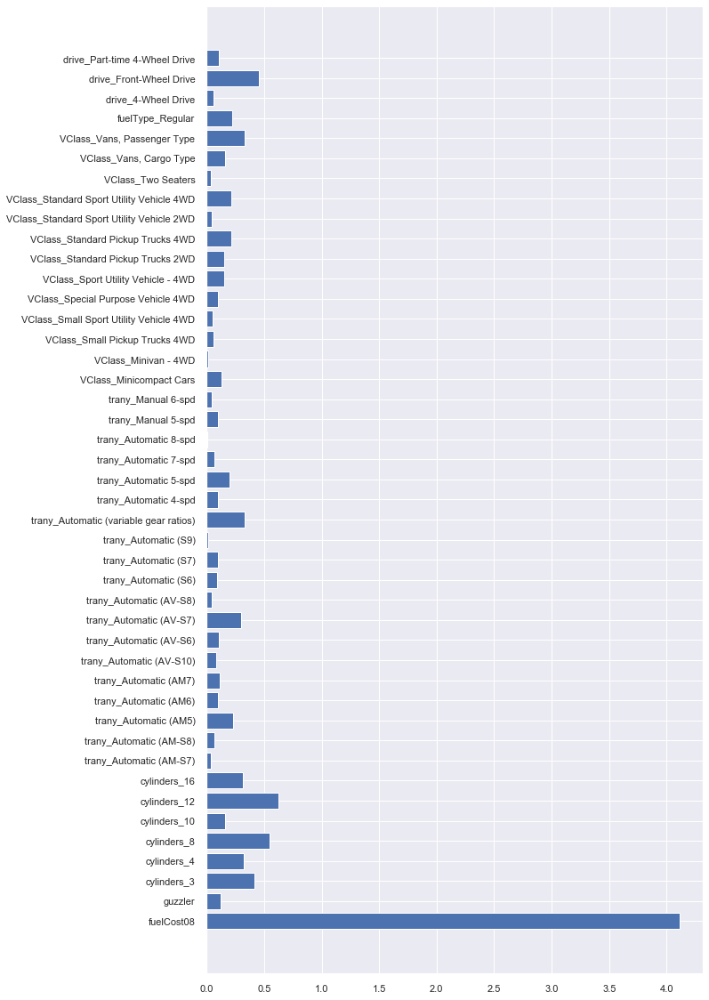

In [27]:
coefs = lasso_gcv.best_estimator_.steps[1][1].coef_
thresh = 0
t_coefs = coefs[coefs>thresh]
plt.figure(figsize=(10, 20))
plt.barh(width=np.abs(t_coefs),y=range(t_coefs.shape[0]),tick_label = x_train.columns[coefs>thresh].values)
plt.show()

The annual fuel cost now becomes the most important predictor now, even more important than the physical parameters.

## Sophisticated models

Can we improve the predictions using more complicated models such as ElasticNet and taking advantage of the important features ?

In the below cells, the analysis is made more sophisticated by using:
* only the most important features according to the feature selection study and an understanding of the data
* the ElasticNet linear model

In [28]:
preproc = gas_car_data[['co2TailpipeGpm','fuelCost08','guzzler','cylinders','trany','VClass','fuelType','drive']].reset_index(drop=True)
preproc = pd.get_dummies(preproc, drop_first=True)
train = gas_car_data['UCity']

In [29]:
from sklearn.linear_model import ElasticNet

x_train, x_test, y_train, y_test = train_test_split(preproc, train, test_size=0.3, random_state=21)

en = ElasticNet(normalize=False)
scaler = StandardScaler()
pipeline = Pipeline([('scale',scaler),('en',en)])

param_grid = {'en__alpha': np.linspace(0.001, 0.01, 5),'en__l1_ratio': [0.25,0.5,0.75]}
en_gcv = GridSearchCV(pipeline, param_grid, cv=3,
                                     n_jobs=-1, iid=True)
time_n = time.time()
en_gcv.fit(x_train, y_train)
time_n = time.time() - time_n 
sc = r2_score(en_gcv.predict(x_test),y_test)
print('The R2 score is: {0}, which means the model explains {1:.2f}% of the variance.'.format(sc,sc*100))
print('Time to complete fitting and scoring: {0:.2f} secs'.format(time_n))

The R2 score is: 0.886784927315195, which means the model explains 88.68% of the variance.
Time to complete fitting and scoring: 68.74 secs


## Stochastic gradient boosted ensembled models with important features

To push the accuracies even further, a gradient boosted trees regressor will be used. 

In [30]:
from sklearn.ensemble import GradientBoostingRegressor
x_train, x_test, y_train, y_test = train_test_split(preproc, train, test_size=0.3, random_state=21)

sgbt = GradientBoostingRegressor(max_features=0.2, max_depth =1, random_state = 32)
pipeline = Pipeline([('gbt',sgbt)])
param_grid = {'gbt__n_estimators': [250,300,350],'gbt__subsample': [0.75,0.8,0.85]}
en_gcv = GridSearchCV(pipeline, param_grid, cv=3,
                                     n_jobs=-1, iid=True)

time_n = time.time()
en_gcv.fit(x_train, y_train)
time_n = time.time() - time_n 
sc = r2_score(en_gcv.predict(x_test),y_test)
print('The R2 score is: {0}, which means the model explains {1:.2f}% of the variance.'.format(sc,sc*100))
print('Time to complete fitting and scoring: {0:.2f} secs'.format(time_n))

The R2 score is: 0.9693531329959107, which means the model explains 96.94% of the variance.
Time to complete fitting and scoring: 32.91 secs


<b>Even without much hyperparameter tuning, the gradient boosted trees regressor generates very accurate predictions and computes faster. This may be due to the fact that some of the most important predictors are categorical variables which lead to non-linear (piecewise-linear) boundaries which can be captured much more accurately using tree-like models.</b>

---

# Mileage over the years

Comparing data over the years can shed light on how mileage of cars have changed over time.


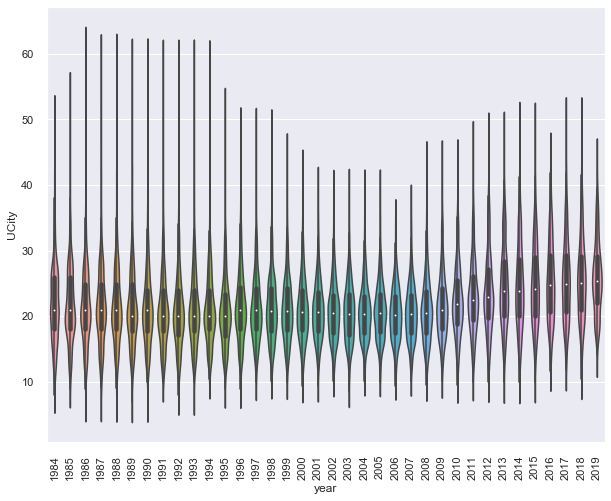

In [31]:
plt.figure(figsize=(10, 8))
sns.violinplot(x=gas_car_data.year.astype(int),y=gas_car_data.UCity)
plt.xticks(rotation=90)
sns.set(font_scale = 1.25)
plt.show()


Visually, it can be seen that the mileages have increased over the years. Great increases can be observed after 2009 which may be attributed with greater regulations by EPA and announcements. But did these changes also manifest themselves in the data ? A comparitive investigation may find the drivers that lead to this increase. 

## Comparison of categoricals before and after 2009

In [32]:
gas_car_data['thresh'] = 'Before or on 2009'
gas_car_data['thresh'][gas_car_data.year.astype(int) >=2010] = 'After 2009'

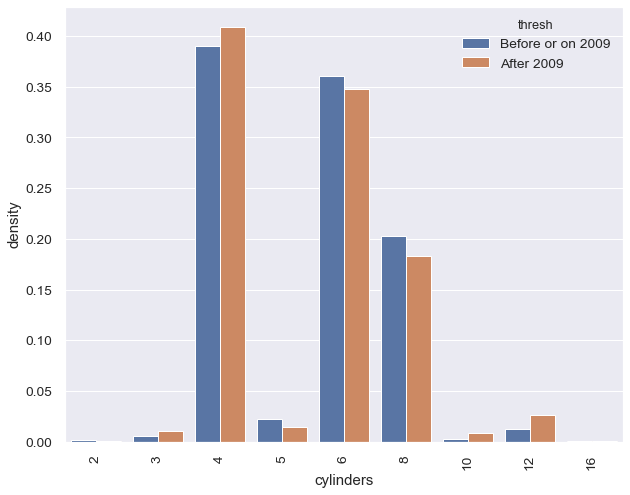

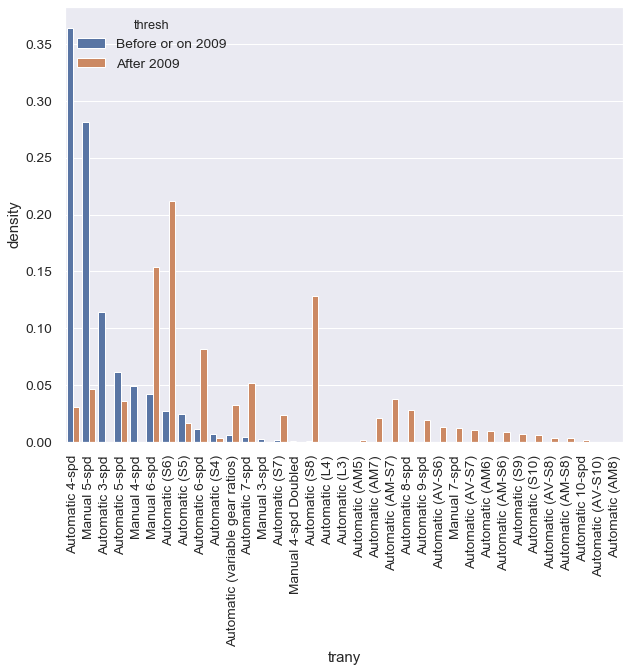

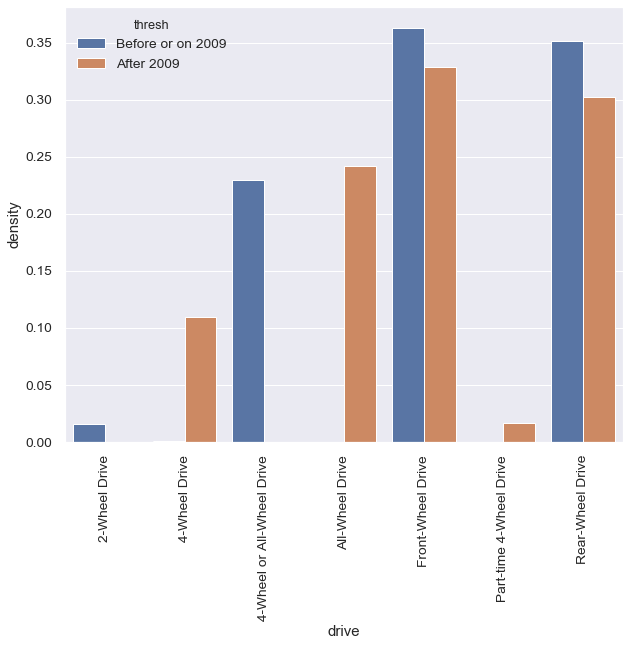

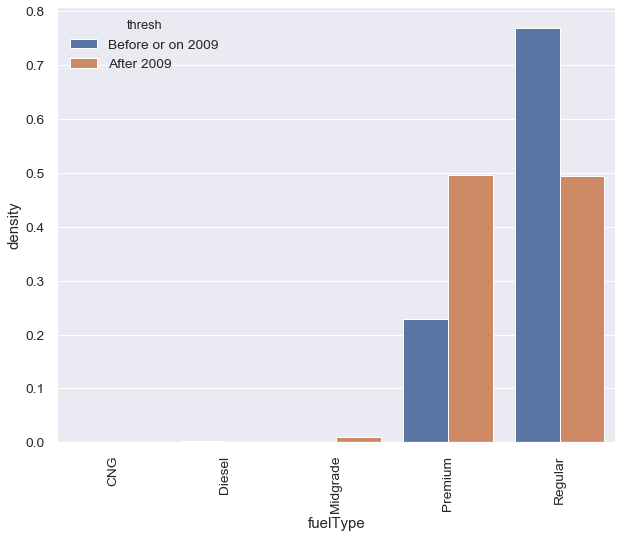

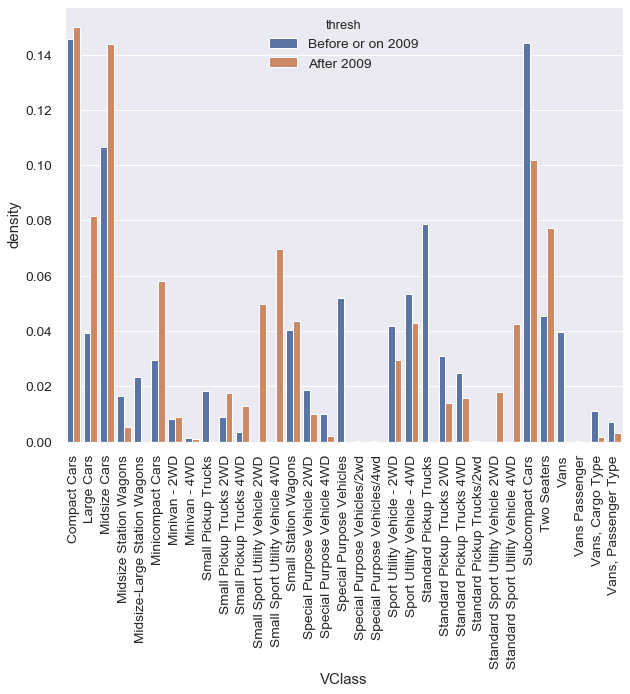

In [33]:
def comp(gas_car_data, var = 'cylinders'):
    """
    Basic function to collect data, normalize counts, and concat for Seaborn plotting.
    """
    temp1 = gas_car_data[gas_car_data['thresh'] == 'Before or on 2009']
    temp1 = temp1[var].value_counts()/temp1.shape[0]
    temp1 = temp1.reset_index()
    temp1.columns=[var,'density']
    
    temp1['thresh'] = 'Before or on 2009'
    temp2 = gas_car_data[gas_car_data['thresh'] == 'After 2009']
    temp2 = temp2[var].value_counts()/temp2.shape[0]
    temp2 = temp2.reset_index()
    temp2.columns=[var,'density']
    temp2['thresh'] = 'After 2009'
    df = pd.concat([temp1,temp2])
    plt.figure(figsize=(10, 8))
    sns.barplot(y='density',x=var,hue='thresh',data=df)
    plt.xticks(rotation=90)
    plt.show()
    
comp(gas_car_data,'cylinders')
comp(gas_car_data,'trany')
comp(gas_car_data,'drive')
comp(gas_car_data,'fuelType')
comp(gas_car_data,'VClass')


Visually glancing at the comparisons, some observations are:
* Slight preference for lower cylinder engines compared to higher cylinder engines since 2009
* Advent of new higher speed automatic and smart transmissions since 2009
* The increased use of higher quality fuel and premium fuel since 2009
* Preference for small sports utility vehicles since 2009

<b>Some or all of these factors may have lead to the collective increase in mileage since 2009.</b>

# References 

## Data Description
vehicle

    atvtype - type of alternative fuel or advanced technology vehicle
    barrels08 - annual petroleum consumption in barrels for fuelType1 (1)
    barrelsA08 - annual petroleum consumption in barrels for fuelType2 (1)
    charge120 - time to charge an electric vehicle in hours at 120 V
    charge240 - time to charge an electric vehicle in hours at 240 V
    city08 - city MPG for fuelType1 (2), (11)
    city08U - unrounded city MPG for fuelType1 (2), (3)
    cityA08 - city MPG for fuelType2 (2)
    cityA08U - unrounded city MPG for fuelType2 (2), (3)
    cityCD - city gasoline consumption (gallons/100 miles) in charge depleting mode (4)
    cityE - city electricity consumption in kw-hrs/100 miles
    cityUF - EPA city utility factor (share of electricity) for PHEV
    co2 - tailpipe CO2 in grams/mile for fuelType1 (5)
    co2A - tailpipe CO2 in grams/mile for fuelType2 (5)
    co2TailpipeAGpm - tailpipe CO2 in grams/mile for fuelType2 (5)
    co2TailpipeGpm- tailpipe CO2 in grams/mile for fuelType1 (5)
    comb08 - combined MPG for fuelType1 (2), (11)
    comb08U - unrounded combined MPG for fuelType1 (2), (3)
    combA08 - combined MPG for fuelType2 (2)
    combA08U - unrounded combined MPG for fuelType2 (2), (3)
    combE - combined electricity consumption in kw-hrs/100 miles
    combinedCD - combined gasoline consumption (gallons/100 miles) in charge depleting mode (4)
    combinedUF - EPA combined utility factor (share of electricity) for PHEV
    cylinders - engine cylinders
    displ - engine displacement in liters
    drive - drive axle type
    emissionsList
    engId - EPA model type index
    eng_dscr - engine descriptor; see http://www.fueleconomy.gov/feg/findacarhelp.shtml#engine
    evMotor - electric motor (kw-hrs)
    feScore - EPA Fuel Economy Score (-1 = Not available)
    fuelCost08 - annual fuel cost for fuelType1 ($) (7)
    fuelCostA08 - annual fuel cost for fuelType2 ($) (7)
    fuelType - fuel type with fuelType1 and fuelType2 (if applicable)
    fuelType1 - fuel type 1. For single fuel vehicles, this will be the only fuel. For dual fuel vehicles, this will be the conventional fuel.
    fuelType2 - fuel type 2. For dual fuel vehicles, this will be the alternative fuel (e.g. E85, Electricity, CNG, LPG). For single fuel vehicles, this field is not used
    ghgScore - EPA GHG score (-1 = Not available)
    ghgScoreA - EPA GHG score for dual fuel vehicle running on the alternative fuel (-1 = Not available)
    guzzler- if G or T, this vehicle is subject to the gas guzzler tax
    highway08 - highway MPG for fuelType1 (2), (11)
    highway08U - unrounded highway MPG for fuelType1 (2), (3)
    highwayA08 - highway MPG for fuelType2 (2)
    highwayA08U - unrounded highway MPG for fuelType2 (2),(3)
    highwayCD - highway gasoline consumption (gallons/100miles) in charge depleting mode (4)
    highwayE - highway electricity consumption in kw-hrs/100 miles
    highwayUF - EPA highway utility factor (share of electricity) for PHEV
    hlv - hatchback luggage volume (cubic feet) (8)
    hpv - hatchback passenger volume (cubic feet) (8)
    id - vehicle record id
    lv2 - 2 door luggage volume (cubic feet) (8)
    lv4 - 4 door luggage volume (cubic feet) (8)
    make - manufacturer (division)
    mfrCode - 3-character manufacturer code
    model - model name (carline)
    mpgData - has My MPG data; see yourMpgVehicle and yourMpgDriverVehicle
    phevBlended - if true, this vehicle operates on a blend of gasoline and electricity in charge depleting mode
    pv2 - 2-door passenger volume (cubic feet) (8)
    pv4 - 4-door passenger volume (cubic feet) (8)
    rangeA - EPA range for fuelType2
    rangeCityA - EPA city range for fuelType2
    rangeHwyA - EPA highway range for fuelType2
    trans_dscr - transmission descriptor; see http://www.fueleconomy.gov/feg/findacarhelp.shtml#trany
    trany - transmission
    UCity - unadjusted city MPG for fuelType1; see the description of the EPA test procedures
    UCityA - unadjusted city MPG for fuelType2; see the description of the EPA test procedures
    UHighway - unadjusted highway MPG for fuelType1; see the description of the EPA test procedures
    UHighwayA - unadjusted highway MPG for fuelType2; see the description of the EPA test procedures
    VClass - EPA vehicle size class
    year - model year
    youSaveSpend - you save/spend over 5 years compared to an average car ($). Savings are positive; a greater amount spent yields a negative number. For dual fuel vehicles, this is the cost savings for gasoline
    sCharger - if S, this vehicle is supercharged
    tCharger - if T, this vehicle is turbocharged
    c240Dscr - electric vehicle charger description
    charge240b - time to charge an electric vehicle in hours at 240 V using the alternate charger
    c240bDscr - electric vehicle alternate charger description
    createdOn - date the vehicle record was created (ISO 8601 format)
    modifiedOn - date the vehicle record was last modified (ISO 8601 format)
    startStop - vehicle has start-stop technology (Y, N, or blank for older vehicles)
    phevCity - EPA composite gasoline-electricity city MPGe for plug-in hybrid vehicles
    phevHwy - EPA composite gasoline-electricity highway MPGe for plug-in hybrid vehicles
    phevComb - EPA composite gasoline-electricity combined city-highway MPGe for plug-in hybrid vehicles

emissions

    emissionsList
        emissionsInfo
            efid - engine family ID
            id - vehicle record ID (links emission data to the vehicle record)
            salesArea - EPA sales area code
            score - EPA 1-10 smog rating for fuelType1
            scoreAlt - EPA 1-10 smog rating for fuelType2
            smartwayScore - SmartWay Code
            standard - Vehicle Emission Standard Code
            stdText - Vehicle Emission Standard

fuel prices

    fuelPrices
        midgrade - $ per gallon of midgrade gasoline(9)
        premium - $ per gallon of premium gasoline(9)
        regular - $ per gallon of regular gasoline(9)
        cng - $ per gallon of gasoline equivalent (GGE) of compressed natural gas(10)
        diesel - $ per gallon of diesel(9)
        e85 - $ per gallon of E85(10)
        electric - $ per kw-hr of electricity(10)
        lpg - $ per gallon of propane(10)

yourMpgVehicle - summary of all My MPG data for this vehicle

    avgMpg - harmonic mean of average MPG shared by fueleconomy.gov users
    cityPercent - average % city miles
    highwayPercent - average % highway miles
    maxMpg - maximum user average MPG
    minMpg - minimum user average MPG
    recordCount - number of records for this vehicle
    vehicleId - vehicle record id (links My MPG data to the vehicle record)

yourMpgDriverVehicle - summary of driver data reported for this vehicle

    cityPercent - user average % city miles
    highwayPercent - user average % highway miles
    lastDate - date records were last updated (yyyy-mm-dd)
    mpg - average MPG
    state - state of residence
    vehicleId - vehicle record ID (links My MPG data to the vehicle record)

Footnotes:

(1) 1 barrel = 42 gallons. Petroleum consumption is estimated using the Department of Energy's GREET model and includes petroleum consumed from production and refining to distribution and final use. Vehicle manufacture is excluded.

(2) The MPG estimates for all 1985-2007 model year vehicles and some 2011-2016 model year vehicles have been updated. Learn More

(3) Unrounded MPG values are not available for some vehicles.

(4) This field is only used for blended PHEV vehicles.

(5) For model year 2013 and beyond, tailpipe CO2 is based on EPA tests. For previous model years, CO2 is estimated using an EPA emission factor. -1 = Not Available.

(6) For PHEVs this is the charge depleting range.

(7) Annual fuel cost is based on 15,000 miles, 55% city driving, and the price of fuel used by the vehicle.

(8) Interior volume dimensions are not required for two-seater passenger cars or any vehicle classified as truck which includes vans, pickups, special purpose vehicles, minivan and sport utility vehicles.

(9) Fuel prices for gasoline and diesel fuel are from the Energy Information Administration and are usually updated weekly.

(10) Fuel prices for E85, LPG, and CNG are from the Office of Energy Efficiency and Renewable Energy's Alternative Fuel Price Report and are updated quarterly.

(11) For electric and CNG vehicles this number is MPGe (gasoline equivalent miles per gallon). 